In [ ]:
#import necessary modules for the project
import pandas as pd
import folium
import matplotlib.pyplot as plt
import numpy as np
from IPython.display import display

In [ ]:


# specify dtype for 'Latitude' column as string to avoid mixed type warning
dtype_spec = {'Latitude': str}

# reading CSV file using pandas
df = pd.read_csv('clustering_data.csv', dtype=dtype_spec)

# convert latitude and longitude columns to string to avoid mixed type warning
df['Latitude'] = df['Latitude'].astype(str)
df['Longitude'] = df['Longitude'].astype(str)
print(df.head())


              CircleName      RegionName       DivisionName  \
0  Andhra Pradesh Circle  Kurnool Region  Hindupur Division   
1  Andhra Pradesh Circle  Kurnool Region  Hindupur Division   
2  Andhra Pradesh Circle  Kurnool Region  Hindupur Division   
3  Andhra Pradesh Circle  Kurnool Region  Hindupur Division   
4  Andhra Pradesh Circle  Kurnool Region  Hindupur Division   

            OfficeName  Pincode OfficeType  Delivery   District  \
0       Peddakotla B.O   515631         BO  Delivery  ANANTAPUR   
1       Pinnadhari B.O   515631         BO  Delivery  ANANTAPUR   
2  Yerraguntapalle B.O   515631         BO  Delivery  ANANTAPUR   
3  Obulareddipalli B.O   515581         BO  Delivery  ANANTAPUR   
4       Odulapalli B.O   515581         BO  Delivery  ANANTAPUR   

        StateName   Latitude  Longitude  
0  ANDHRA PRADESH    14.5689   77.85624  
1  ANDHRA PRADESH    14.5281  77.857014  
2  ANDHRA PRADESH  14.561111   77.85715  
3  ANDHRA PRADESH    14.2488    78.2588  
4  ANDHR

In [ ]:
# to check headings of the each individual column
df.columns

Index(['CircleName', 'RegionName', 'DivisionName', 'OfficeName', 'Pincode',
       'OfficeType', 'Delivery', 'District', 'StateName', 'Latitude',
       'Longitude'],
      dtype='object')

In [ ]:


# Getting data for UTTAR_PRADESH only
up_data = df[df['StateName'] == 'UTTAR PRADESH'].copy()
 # Make a copy to avoid SettingWithCopyWarning


# finding out min and max longitude and latitude from the data
max_lat = up_data['Latitude'].max()
min_lat = up_data['Latitude'].min()
max_lon = up_data['Longitude'].max()
min_lon = up_data['Longitude'].min()

up_data_cleaned = up_data.dropna().copy()

# Convert latitude and longitude columns to numeric
up_data_cleaned.loc[:, 'Latitude'] = pd.to_numeric(up_data_cleaned['Latitude'], errors='coerce')
up_data_cleaned.loc[:, 'Longitude'] = pd.to_numeric(up_data_cleaned['Longitude'], errors='coerce')

# Drop rows with missing values after converting to numeric
up_data_cleaned = up_data_cleaned.dropna(subset=['Latitude', 'Longitude'])

# Define geographic boundaries for India
# min_lat, max_lat = 8.0, 37.0
# min_lon, max_lon = 68.0, 98.0

# Filter points within India boundaries
up_data_cleaned = up_data_cleaned[(up_data_cleaned['Latitude'] >= min_lat) &
                                  (up_data_cleaned['Latitude'] <= max_lat) &
                                  (up_data_cleaned['Longitude'] >= min_lon) &
                                  (up_data_cleaned['Longitude'] <= max_lon)]



In [ ]:


# Converting normally was giving type error so loc is used to supress it
up_data_cleaned.loc[:, 'Latitude'] = pd.to_numeric(up_data_cleaned['Latitude'], errors='coerce')
up_data_cleaned.loc[:, 'Longitude'] = pd.to_numeric(up_data_cleaned['Longitude'], errors='coerce')

# Cleaned data with valid numeric latitude and longitude
up_data_cleaned = up_data_cleaned.dropna()

# Create a folium map centered around India
map_india = folium.Map(location=[20.5937, 78.9629], zoom_start=5)

folium.TileLayer('cartodb positron').add_to(map_india)


up_boundary = [[27.0, 77.0], [28.0, 78.5]]

# Add a GeoJson layer or a polygon to highlight Uttar Pradesh
folium.PolyLine(locations=up_boundary, color='red', weight=2.5, opacity=1).add_to(map_india)

# Add markers for each pincode location in Uttar Pradesh
for index, row in up_data_cleaned.iterrows():
    folium.Marker([row['Latitude'], row['Longitude']], popup=row['Pincode']).add_to(map_india)

# Display the map inline
map_india

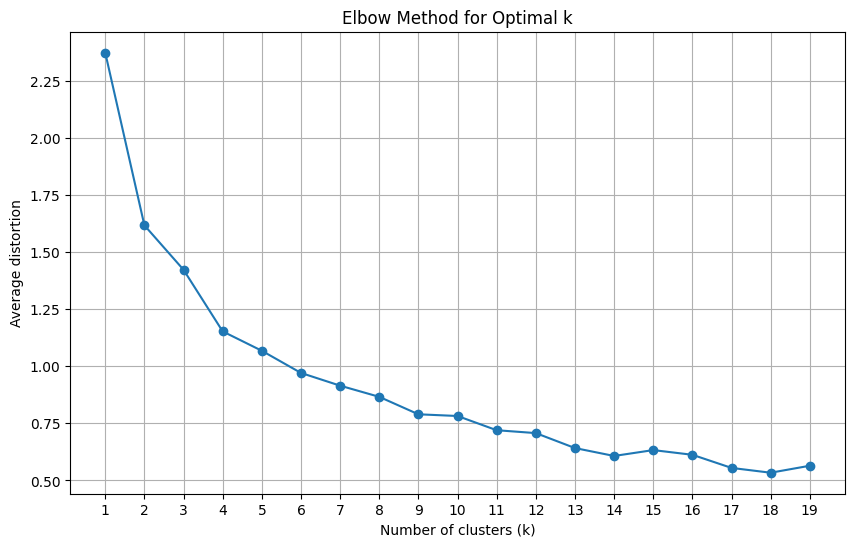

In [ ]:
# converted values to float
X = up_data_cleaned[['Latitude', 'Longitude']].values.astype(float)

class KMeans:
    def __init__(self, n_clusters, max_iters=300):
        self.n_clusters = n_clusters
        self.max_iters = max_iters

    def fit(self, X):
        # Randomly initialize centroids from  the data
        self.centroids = X[np.random.choice(X.shape[0], self.n_clusters, replace=False)]

        for _ in range(self.max_iters):
            # Assign each point to the nearest centroid
            labels = self.assign_labels(X)

            # Update centroids based on mean of points assigned to each centroid
            new_centroids = self.update_centroids(X, labels)

            # Check for convergence of centroids
            if np.allclose(new_centroids, self.centroids):
                break
            self.centroids = new_centroids

        self.labels_ = labels
        return self

    def assign_labels(self, X):
        distances = np.linalg.norm(X[:, np.newaxis] - self.centroids, axis=2)
        return np.argmin(distances, axis=1)

    def update_centroids(self, X, labels):
        new_centroids = np.zeros((self.n_clusters, X.shape[1]))
        for k in range(self.n_clusters):
            cluster_points = X[labels == k]
            if len(cluster_points) > 0:
                new_centroids[k] = cluster_points.mean(axis=0)
            else:
                new_centroids[k] = X[np.random.choice(X.shape[0])]
        return new_centroids

    def predict(self, X):
        distances = np.linalg.norm(X[:, np.newaxis] - self.centroids, axis=2)
        return np.argmin(distances, axis=1)

    def get_centroid_labels(self):
        return self.labels_



# filtering data points
X_filtered = X[(X[:, 0] >= min_lat) & (X[:, 0] <= max_lat) & (X[:, 1] >= min_lon) & (X[:, 1] <= max_lon)]

# using elbow method to decide what optimal k to use
distortions = []
K_range = range(1, 20)

for k in K_range:
    kmeans = KMeans(n_clusters=k)
    kmeans.fit(X_filtered)
    distortions.append(np.sum(np.min(np.linalg.norm(X_filtered[:, np.newaxis] - kmeans.centroids, axis=2), axis=1)) / X_filtered.shape[0])

# plot the elbow curve
plt.figure(figsize=(10, 6))
plt.plot(K_range, distortions, marker='o')
plt.title('Elbow Method for Optimal k')
plt.xlabel('Number of clusters (k)')
plt.ylabel('Average distortion')
plt.xticks(K_range)
plt.grid(True)
plt.show()


In [ ]:
best_k = 16
kmeans = KMeans(n_clusters=best_k)
kmeans.fit(X_filtered)
labels = kmeans.predict(X_filtered)

# visualize clusters on the map
map_clusters = folium.Map(location=[27.0, 80.0], zoom_start=7)

# add markers for each point colored by cluster
colors = [
    'red', 'blue', 'green', 'purple', 'orange', 'darkred',
    'lightred', 'beige', 'darkblue', 'darkgreen', 'cadetblue',
    'darkpurple', 'lightblue', 'lightgreen', 'pink', 'gray'
]
for point, label in zip(X_filtered, labels):
    folium.CircleMarker(
        location=[point[0], point[1]],
        radius=5,
        color=None,
        fill=True,
        fill_color=colors[label],
        fill_opacity=0.7,
        popup=f'Cluster {label}'
    ).add_to(map_clusters)

# display the map
map_clusters


In [ ]:

# getting centoids of each cluster in order to draw it on the map
centroids = kmeans.centroids

# print the centroids with their coordinates i.e. latitude and longitude
for i, centroid in enumerate(centroids):
    print(f"Cluster {i} centroid: Latitude = {centroid[0]}, Longitude = {centroid[1]}")


Cluster 0 centroid: Latitude = 27.774896793074582, Longitude = 80.40150058660575
Cluster 1 centroid: Latitude = 18.999356132989707, Longitude = 79.73229826615113
Cluster 2 centroid: Latitude = 26.59643448542708, Longitude = 79.4862038972363
Cluster 3 centroid: Latitude = 26.46201026372022, Longitude = 82.26246231457816
Cluster 4 centroid: Latitude = 25.244095472675514, Longitude = 82.48060222146746
Cluster 5 centroid: Latitude = 25.814692173570773, Longitude = 80.56682334916889
Cluster 6 centroid: Latitude = 23.73596584909091, Longitude = 72.59684063818182
Cluster 7 centroid: Latitude = 29.208539586143022, Longitude = 77.64414378263098
Cluster 8 centroid: Latitude = 28.523712510442877, Longitude = 79.13816678395982
Cluster 9 centroid: Latitude = 25.96879034077375, Longitude = 83.86933784080333
Cluster 10 centroid: Latitude = 24.805328053829783, Longitude = 78.72119730617021
Cluster 11 centroid: Latitude = 26.922329397740523, Longitude = 83.23047527558258
Cluster 12 centroid: Latitude =

In [ ]:


# display centroids on the new map
map_clusters = folium.Map(location=[27.0, 80.0], zoom_start=7)

# add markers for centroids
for i, centroid in enumerate(centroids):
    folium.Marker(
        location=[centroid[0], centroid[1]],
        popup=f'Cluster {i+1} centroid',
        icon=folium.Icon(color='blue')  # Customize marker color as needed
    ).add_to(map_clusters)

# display the map inline
display(map_clusters)
